In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import scipy
from  bitstring import BitArray
import binascii

In [12]:
df = pd.read_csv("processed_demods3.csv")
df = df[df.average_prob>0.5]
df = df[df.cutoff_frq<700]
df.sort_values(by="num_packets")

,trans_wdth,omega_limit,gain_mu,cutoff_frq,average_prob,num_packets
150,400.0,0.335,0.74,200.0,0.725000,1
155,400.0,0.351,0.23,200.0,0.705000,1
86,300.0,0.307,0.35,200.0,0.705000,1
139,300.0,0.296,0.66,200.0,0.705000,1
53,300.0,0.314,0.35,200.0,0.705000,1
44,400.0,0.097,0.28,200.0,0.727500,2
138,400.0,0.146,0.43,200.0,0.721667,3
165,500.0,0.136,0.58,200.0,0.753125,8
60,700.0,0.008,0.69,600.0,0.762500,8
146,800.0,0.236,0.20,600.0,0.762500,8


In [13]:
df.corr()

,trans_wdth,omega_limit,gain_mu,cutoff_frq,average_prob,num_packets
trans_wdth,1.000000,0.113356,0.089025,0.010500,0.168034,0.101620
omega_limit,0.113356,1.000000,-0.070354,-0.039787,0.005153,-0.090281
gain_mu,0.089025,-0.070354,1.000000,-0.055337,-0.077448,0.033685
cutoff_frq,0.010500,-0.039787,-0.055337,1.000000,0.144178,0.166970
average_prob,0.168034,0.005153,-0.077448,0.144178,1.000000,0.655811
num_packets,0.101620,-0.090281,0.033685,0.166970,0.655811,1.000000


In [5]:
df = pd.read_csv("processed_demods2.csv")
df = df[df.average_prob>0.5]
df.sort_values(by= "average_prob")

,trans_wdth,omega_limit,gain_mu,cutoff_frq,average_prob,num_packets
255,300.0,0.268,0.12,200.0,0.705000,1
507,100.0,0.023,0.07,300.0,0.707500,2
140,500.0,0.016,0.78,100.0,0.708333,3
71,500.0,0.038,0.30,100.0,0.710000,3
12,500.0,0.022,0.34,100.0,0.712500,2
7,500.0,0.030,0.49,100.0,0.715000,1
454,500.0,0.013,0.85,100.0,0.715000,5
235,400.0,0.131,0.60,200.0,0.716667,3
166,200.0,0.004,0.56,700.0,0.717000,5
122,100.0,0.004,0.80,700.0,0.717000,5


In [6]:
df.corr()

,trans_wdth,omega_limit,gain_mu,cutoff_frq,average_prob,num_packets
trans_wdth,1.000000,0.097133,0.028310,-0.151294,0.214665,0.142747
omega_limit,0.097133,1.000000,0.033088,0.078580,0.015924,0.018345
gain_mu,0.028310,0.033088,1.000000,-0.011679,-0.024681,0.008667
cutoff_frq,-0.151294,0.078580,-0.011679,1.000000,-0.199905,-0.216740
average_prob,0.214665,0.015924,-0.024681,-0.199905,1.000000,0.734126
num_packets,0.142747,0.018345,0.008667,-0.216740,0.734126,1.000000


In [14]:
df = pd.read_csv("processed_demods.csv")
df.corr()[['average_prob','number_of_packets']]

,average_prob,number_of_packets
trans_wdth,0.243676,0.151784
omega_limit,0.016227,0.005255
gain_mu,-0.056799,-0.037207
cutoff_freq,-0.317702,-0.621614
average_prob,1.000000,0.580958
number_of_packets,0.580958,1.000000


In [15]:
df.sort_values(by='average_prob')

,trans_wdth,omega_limit,gain_mu,cutoff_freq,average_prob,number_of_packets
151,100.0,0.003,0.250,300.0,0.738182,11
105,400.0,0.003,0.170,900.0,0.742143,7
202,100.0,0.005,0.140,300.0,0.743333,12
100,200.0,0.003,0.290,300.0,0.750000,7
43,400.0,0.003,0.210,900.0,0.750000,8
102,200.0,0.003,0.280,300.0,0.751316,19
120,200.0,0.007,0.260,300.0,0.751739,23
167,100.0,0.005,0.190,900.0,0.752273,11
123,400.0,0.009,0.270,900.0,0.753125,8
189,400.0,0.009,0.130,900.0,0.753333,9


In [16]:
df.sort_values(by='number_of_packets')

,trans_wdth,omega_limit,gain_mu,cutoff_freq,average_prob,number_of_packets
217,400.0,0.001,0.20,900.0,0.761667,3
133,100.0,0.005,0.17,800.0,0.798000,5
174,200.0,0.006,0.29,900.0,0.775000,5
154,400.0,0.001,0.14,900.0,0.788000,5
193,300.0,0.003,0.19,900.0,0.778000,5
197,300.0,0.006,0.19,900.0,0.780000,5
15,200.0,0.009,0.15,900.0,0.769000,5
220,500.0,0.001,0.09,900.0,0.775714,7
100,200.0,0.003,0.29,300.0,0.750000,7
178,300.0,0.001,0.12,900.0,0.797143,7


In [17]:
np.u
binary_data =scipy.fromfile(open('../data_files/demoded_data'), dtype=scipy.float32).astype(scipy.uint)[::-1]
#(binary_data==binary_data2)

In [18]:
resulting_hex = ("").join(map(str,binary_data))

expected_hex = BitArray(hex ="0xf9df21980fe6e93173d80f7878ecc97b10f6988c030839b63708063680391ef8c4fec8318c7877ee39c77353089ecf11411f40153d0f6b81a32cb2cf1cc39a4e3c3d12c79b71f92767999d978088d818856e88eb538f4beccb01e6f3b1d496e1b46e33d0201a3f50b5abcaa4e86eb58a680a8a5bea4afafb6f4c487f3dabe29523f03fcb69fd736feb39bcbdfe1f47e60bebf8eebdef52eb777f39f79cb90e47ca622730655ce087e505c27aa6cb4b16711eabf2b8b394ac46ad2a894b994e6543f56e69a9a9a2894eb3764669e9326b6315abaa55b553b5946b0e55e6d5b4d50ace29b62d1de564a9c876ba08b6f005a9cfafce2a2ea9e2d2526ae82a9c652a6be5a5280055a5c9da30279a1a96cce5d694aad61af7b5552f7bda780b312745547dfd5056dd5a61638362a4067bbba3441a40e54d5604b8a816212a369d85b5223f2664e588a20ca24b99566a65db6f448e2d615fd058fcbb46cd3380a646201668662b172bb81fd9ffe5ab53a6e1dee8c5e3e800ae7989a6aae41465e52b13a0290e1430c253ce8cd29830a8a2dcc171e8c988b55a18993c0be59254e2a42617d66a306556c1219c5e97ea33589610eb9a6ddd1996bd3b03b00cf8c481c9e7b19d6d6243ae4ad453225893f2691c097774cf1e12034c0f7b123c61e63f263e0134f3b2526de73deb32f60acfacb693ab93cca6937d85694a11852758e2025623a2ba291352adbed550523db180d7901efdb5feaaa96d4769b9d4f3202bbbdec242fabfabeb9e6a69e940bb9ab2539569aa55b5ea9cca5a3d95c452da945acada6c95b6ac9245a49aaa524aa5cc6d55558b1aa71239ad6bb1a498a4b4dbdab498bd5acb325bd526abaa363355709369154d5daab24b4a92b69db65aa9cca6bbd492e2cad69a5597aa58ce5b5041a3669973bfd44a5a4a2aabb4488bb1ddb459c1a8d4762ea65445d39b51b5559a57a5b86c81bca76d85abf28649d7b085eb58da6a627ec711a6a55efaf3e0f6e34b8b48d3af5721aea982e7ec1ad414e184a8be3b0216fbae80b7f24c60cac7fc1e40cc0c4c77f110580a24270e4fc946158868eac84dc6d68d6368815b008f4fb708ca1597d8a207326f09767072ddfa07c3c8ddc3c820e175043ec1c049ac2df6f67d7717ea2c0b382c9737b48a2b0c820058e2705c10b704accab1f4f351986032b87cd01d898104e20008898751cd5661886b541c31f8391d07fca72bfe11305d3a14ff9007446060bf23009f87ea587e6df5f24beb2e467427b22c3e0a037a5eebef5a77d5cc072dda24e65fb8a2b0f5fd4857742e56f1e18d5b74c4a40a0498c550d0a6e783934158fdf57bdfebf51730460bb2748fd6301b50646a5eaf67859a695597637510cf5a9e7704c83f8f9b4f8fb409dbca8fa28f2345e77cbe78ca9bba9aa60fe22fe2694e33dc44fea58472d8910bd4791eaf8f3a81579eeded").bin

expected_hex[-300:-100] in resulting_hex

False

In [19]:
sum([expected_hex[i:i+10*8] in resulting_hex for i in range(len(expected_hex))])
#binary_data[0:234]

27

for i in range(100):
    fig = plt.figure(figsize=(30,6))
    ax = fig.add_subplot(111)
    index = i*500
    plt.plot(range(len(binary_data[index:index+500])),binary_data[index:index+500])
    plt.show()

In [5]:
from ble_dump_utils import *

In [6]:
index = 0
size = 65*8
length = len(binary_data)
target = "0xaad6be898e"#95c9b2647e33cce2f4e48b6ec302"
while (index+size)<length:
    conv = Convolution(target, "");
    conv.search_vect = ("").join(map(str,binary_data[index:index+size]))
    conv.convolve();
    conv.info();
    index+=size-8*15
    

value: 36 n: 40
detected: aad636cd8e
errors: 4


In [1]:
#np.dot(np.conj(cmplx_data),cmplx_data)

In [66]:
#np.dot(np.conj(cmplx_data1),cmplx_data1)

In [67]:
#np.dot(np.conj(cmplx_data2),cmplx_data2)

In [72]:
import binascii
ble_data = binascii.hexlify(bytearray(binary_data))

In [74]:
ble_data

'5730e8fd3568e2feff7ffeffffffffeffff7fffffdfffffffffffffffffffffffffbfffffc0fefc25c06007ea995e788cc58fc555fd05e9b6786a1422c76a747ee91303ce158c7745c278a1cba22aca1c3be97a6c5fe5272f92b37ff5e75c0befffffffffffffffebfe1ffffffffffffffefc59ced67b71833e7cd0b87cd4d82620cf9150667761ffb0af814efef3e6965e0cc2ad83d6fa823faf27fc6b46bc2e2cd83cf96b0597c902247dd2ca6c66e62d4fa8aef4f7265d57365dc510c1cb8e3cf72744849380699c64df713a2fdc41ff096b6df738afdb3050148d6cdcdecace64664941865980eabeff88f0b1ae6d46f0cbcc5f7b18e3c7c571cbf8babc00efddbbf701ef3f323e10c854160852adddf8c3fc2617c6a718e0300372851feaf0dc09ba903451e6f4b67a2106cd8373b8d84eb779791fc772acbbf4518234a0240630c677d5b4706e7497b97778cf9a1a73cd810dcb6c35df5bdc1f0bf59c1bfdaaadf15a399d77f3cfb0ce283f32ffcf19d29d3c0aa31c658128148432012da87a2ee6330fa7cf9d50cdf60e74ccdf9b5f016efae8f41ce99e6bab1de57739afe33474e51d8e0e9390f46b1db5b91a3de7a3b3c40bff4e920f81903e9ac20ffd3b82bfe34563ae3cd6e6d1f64e11f6384d9473a47cb0b376da98302cad325a189f701e607487fd0ffb1f229296471c8ca43f

tags_mac_front = "4cb82c24"


In [73]:
tags_mac_front = "8e89bed6"
print tags_mac_front in ble_data

False


In [100]:
class ByteMap:
  def __init__(self, num_items):
    self.arr = [0]*num_items
  def push(self,item):
    self.arr.append(item)
    self.arr.pop(0)

In [101]:
arr = ByteMap(3)

In [103]:
for i in range(10):
    arr.push(i)
    print arr.arr

 [0, 0, 0]
[0, 0, 1]
[0, 1, 2]
[1, 2, 3]
[2, 3, 4]
[3, 4, 5]
[4, 5, 6]
[5, 6, 7]
[6, 7, 8]
[7, 8, 9]


[3, 0] 2
[3, 0, 1] 3
[3, 0, 1] 4
[3, 0, 1] 4
[3, 0, 1] 4
[3, 0, 1] 4
[3, 0, 1] 4
[3, 0, 1] 4
[3, 0, 1] 4
[3, 0, 1] 4


In [4]:
import pandas as pd
df1 = pd.read_csv('file_based_sim6.csv')
df2 = pd.read_csv('file_based_sim7.csv')
df = pd.concat([df1,df2])
df.sort_values(by='processed')
_df = df.assign(f = (df['processed']+1.0)/(df['detected']+1.0)*df['processed']).sort_values(by="processed")
_df

,Unnamed: 0,cutoff_freq,detected,freq_offset,gfsk_gain_mu,gfsk_omega_limit,processed,transition_width,f
0,0,600,13,5000.0,2.00,0.51,4,1000.0,1.428571
0,0,600,230,5000.0,1.40,0.51,55,800.0,13.333333
2200,2200,600,523,2300.0,0.80,0.31,83,650.0,13.305344
11343,11343,600,523,2200.0,0.73,0.16,85,750.0,13.950382
15320,15320,600,450,3700.0,0.19,0.49,85,200.0,16.208426
14511,14511,600,506,-900.0,0.16,0.12,88,650.0,15.447732
2793,2793,600,506,-600.0,1.85,0.24,88,750.0,15.447732
9924,9924,600,514,-1900.0,0.47,0.31,89,800.0,15.553398
9937,9937,600,509,2300.0,0.24,0.19,89,700.0,15.705882
12604,12604,600,507,3200.0,0.69,0.07,90,750.0,16.122047


In [3]:
_df.corr()[["processed","detected",'f']]

,processed,detected,f
Unnamed: 0,-0.040406,-0.074948,-0.020474
cutoff_freq,NaN,NaN,NaN
detected,0.042068,1.000000,-0.212166
freq_offset,-0.001501,-0.013018,0.000800
gfsk_gain_mu,0.004563,-0.005943,0.006335
gfsk_omega_limit,0.000918,-0.013026,0.004330
processed,1.000000,0.042068,0.964457
transition_width,-0.119474,-0.141568,-0.079986
f,0.964457,-0.212166,1.000000


In [87]:


import numpy as np
import matplotlib.pyplot as plt 
def co_plot(lists):
    fig = plt.figure(figsize=(20,12))
    ax = fig.add_subplot(111)
    x = range(len(lists[0]))
    for l in lists:
        ax.plot(x, l)
    plt.show()
def same_peak(ls):
    new_ls=[]
    
    _peak = max(list(map(max,ls)))
    for l in ls:
        l = l+_peak-max(l)
        new_ls.append(l)
    return new_ls
    

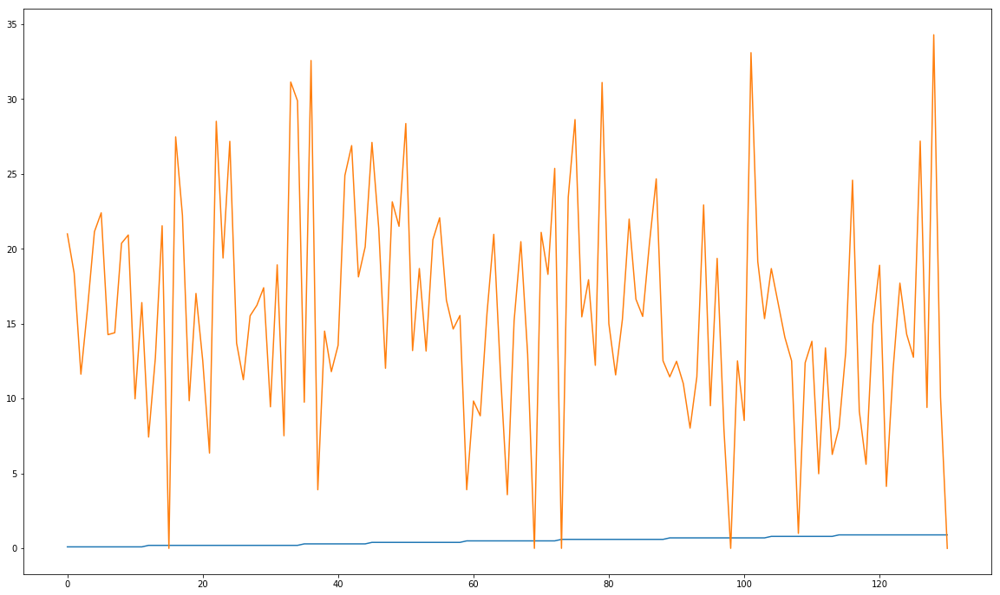

In [92]:
keys =["gfsk_gain_mu","f"] #["gfsk_gain_mu","gfsk_omega_limit","rf_gain","sqlch_thrsh","f"]
keys1= ["gfsk_omega_limit","f"]
keys1= ["gfsk_gain_mu","f"]
keys1= ["gfsk_gain_mu","f"]

lists = [_df[key].values for key in keys]
#ls = same_peak(lists)
co_plot(lists)

In [90]:
import random
_list = [(-30, 1.0999999999999999, 70, 0.05500000000000001, 0.2), (-30, 1.0999999999999999, 70, 0.05500000000000001, 0.30000000000000004), (-30, 1.0999999999999999, 70, 0.05500000000000001, 0.4), (-30, 1.0999999999999999, 70, 0.05500000000000001, 0.5), (-30, 1.0999999999999999, 70, 0.05500000000000001, 0.6), (-30, 1.0999999999999999, 70, 0.05500000000000001, 0.7), (-30, 1.0999999999999999, 70, 0.05500000000000001, 0.7999999999999999), (-30, 1.0999999999999999, 70, 0.05500000000000001, 0.8999999999999999), (-30, 1.0999999999999999, 70, 0.065, 0.1), (-30, 1.0999999999999999, 70, 0.065, 0.2), (-30, 1.0999999999999999, 70, 0.065, 0.30000000000000004), (-30, 1.0999999999999999, 70, 0.065, 0.4), (-30, 1.0999999999999999, 70, 0.065, 0.5), (-30, 1.0999999999999999, 70, 0.065, 0.6), (-30, 1.0999999999999999, 70, 0.065, 0.7), (-30, 1.0999999999999999, 70, 0.065, 0.7999999999999999), (-30, 1.0999999999999999, 70, 0.065, 0.8999999999999999), (-30, 1.0999999999999999, 70, 0.075, 0.1), (-30, 1.0999999999999999, 70, 0.075, 0.2), (-30, 1.0999999999999999, 70, 0.075, 0.30000000000000004), (-30, 1.0999999999999999, 70, 0.075, 0.4), (-30, 1.0999999999999999, 70, 0.075, 0.5), (-30, 1.0999999999999999, 70, 0.075, 0.6), (-30, 1.0999999999999999, 70, 0.075, 0.7), (-30, 1.0999999999999999, 70, 0.075, 0.7999999999999999), (-30, 1.0999999999999999, 70, 0.075, 0.8999999999999999), (-30, 1.0999999999999999, 70, 0.08499999999999999, 0.1), (-30, 1.0999999999999999, 70, 0.08499999999999999, 0.2), (-30, 1.0999999999999999, 70, 0.08499999999999999, 0.30000000000000004), (-30, 1.0999999999999999, 70, 0.08499999999999999, 0.4), (-30, 1.0999999999999999, 70, 0.08499999999999999, 0.5), (-30, 1.0999999999999999, 70, 0.08499999999999999, 0.6), (-30, 1.0999999999999999, 70, 0.08499999999999999, 0.7), (-30, 1.0999999999999999, 70, 0.08499999999999999, 0.7999999999999999), (-30, 1.0999999999999999, 70, 0.08499999999999999, 0.8999999999999999), (-30, 1.0999999999999999, 70, 0.09499999999999999, 0.1), (-30, 1.0999999999999999, 70, 0.09499999999999999, 0.2), (-30, 1.0999999999999999, 70, 0.09499999999999999, 0.30000000000000004), (-30, 1.0999999999999999, 70, 0.09499999999999999, 0.4), (-30, 1.0999999999999999, 70, 0.09499999999999999, 0.5), (-30, 1.0999999999999999, 70, 0.09499999999999999, 0.6), (-30, 1.0999999999999999, 70, 0.09499999999999999, 0.7), (-30, 1.0999999999999999, 70, 0.09499999999999999, 0.7999999999999999), (-30, 1.0999999999999999, 70, 0.09499999999999999, 0.8999999999999999), (-30, 1.0999999999999999, 70, 0.10499999999999998, 0.1), (-30, 1.0999999999999999, 70, 0.10499999999999998, 0.2), (-30, 1.0999999999999999, 70, 0.10499999999999998, 0.30000000000000004), (-30, 1.0999999999999999, 70, 0.10499999999999998, 0.4), (-30, 1.0999999999999999, 70, 0.10499999999999998, 0.5), (-30, 1.0999999999999999, 70, 0.10499999999999998, 0.6), (-30, 1.0999999999999999, 70, 0.10499999999999998, 0.7), (-30, 1.0999999999999999, 70, 0.10499999999999998, 0.7999999999999999), (-30, 1.0999999999999999, 70, 0.10499999999999998, 0.8999999999999999), (-30, 1.0999999999999999, 70, 0.11499999999999998, 0.1), (-30, 1.0999999999999999, 70, 0.11499999999999998, 0.2), (-30, 1.0999999999999999, 70, 0.11499999999999998, 0.30000000000000004), (-30, 1.0999999999999999, 70, 0.11499999999999998, 0.4), (-30, 1.0999999999999999, 70, 0.11499999999999998, 0.5), (-30, 1.0999999999999999, 70, 0.11499999999999998, 0.6), (-30, 1.0999999999999999, 70, 0.11499999999999998, 0.7), (-30, 1.0999999999999999, 70, 0.11499999999999998, 0.7999999999999999), (-30, 1.0999999999999999, 70, 0.11499999999999998, 0.8999999999999999)]
random.shuffle(_list)
print _list

[(-30, 1.0999999999999999, 70, 0.08499999999999999, 0.7), (-30, 1.0999999999999999, 70, 0.08499999999999999, 0.1), (-30, 1.0999999999999999, 70, 0.11499999999999998, 0.7999999999999999), (-30, 1.0999999999999999, 70, 0.09499999999999999, 0.6), (-30, 1.0999999999999999, 70, 0.05500000000000001, 0.6), (-30, 1.0999999999999999, 70, 0.05500000000000001, 0.8999999999999999), (-30, 1.0999999999999999, 70, 0.10499999999999998, 0.5), (-30, 1.0999999999999999, 70, 0.11499999999999998, 0.7), (-30, 1.0999999999999999, 70, 0.065, 0.7), (-30, 1.0999999999999999, 70, 0.08499999999999999, 0.6), (-30, 1.0999999999999999, 70, 0.065, 0.2), (-30, 1.0999999999999999, 70, 0.075, 0.6), (-30, 1.0999999999999999, 70, 0.11499999999999998, 0.6), (-30, 1.0999999999999999, 70, 0.075, 0.2), (-30, 1.0999999999999999, 70, 0.075, 0.1), (-30, 1.0999999999999999, 70, 0.11499999999999998, 0.2), (-30, 1.0999999999999999, 70, 0.075, 0.4), (-30, 1.0999999999999999, 70, 0.11499999999999998, 0.4), (-30, 1.0999999999999999, 7

In [3]:
import pandas as pd
df_0 = pd.read_csv('file_based_sim3.csv')
df_1 = pd.read_csv('file_based_sim4.csv')
df_2 = pd.read_csv('file_based_sim5.csv')
__df__ = pd.concat([df_0,df_1,df_2],ignore_index=True)
__df__.to_csv("v2_comparison.csv")
__df__.sort_values(by='processed')
_df_ = __df__.assign(f = (__df__['processed']+1.0)/(__df__['detected']+1.0)*__df__['processed']).sort_values(by="f")
_df_

,Unnamed: 0,cutoff_freq,detected,gfsk_gain_mu,gfsk_omega_limit,processed,transition_width',f
615,615,600,32,0.53,0.045,7,800.0,1.696970
1193,1193,600,55,0.80,0.215,14,650.0,3.750000
597,597,600,28,0.19,0.325,11,650.0,4.551724
1053,1053,600,73,1.72,0.005,18,700.0,4.621622
1560,333,600,81,1.76,0.180,19,150.0,4.634146
1215,1215,600,72,0.83,0.455,18,750.0,4.684932
1118,1118,600,61,0.17,0.255,17,450.0,4.935484
1125,1125,600,61,1.88,0.305,17,800.0,4.935484
1199,1199,600,75,0.64,0.285,19,250.0,5.000000
861,861,600,70,1.69,0.235,19,450.0,5.352113


In [4]:
_df_.corr()[["processed","detected",'f']]

,processed,detected,f
Unnamed: 0,-0.434758,-0.431932,-0.401287
cutoff_freq,NaN,NaN,NaN
detected,0.951792,1.000000,0.830846
gfsk_gain_mu,-0.048771,-0.048077,-0.044572
gfsk_omega_limit,0.027682,0.021090,0.031012
processed,1.000000,0.951792,0.960690
transition_width',-0.034545,-0.025219,-0.038681
f,0.960690,0.830846,1.000000


In [19]:
import pandas as pd
__df__ = pd.read_csv('file_based_sim5.csv')
__df__.to_csv("v2_comparison.csv")
__df__.sort_values(by='processed')
_df_ = __df__.assign(f = (__df__['processed']+__df__['detected'])*((__df__['processed']+1.0)/(__df__['detected']+1.0))).sort_values(by="f")
_df_

,Unnamed: 0,cutoff_freq,detected,gfsk_gain_mu,gfsk_omega_limit,processed,transition_width',f
0,0,600,181,2.00,0.51,80,1000.0,116.159341
211,211,600,200,1.88,0.48,85,450.0,121.940299
6,6,600,208,0.68,0.20,86,200.0,122.382775
228,228,600,236,1.71,0.17,90,450.0,125.172996
17,17,600,196,1.99,0.26,88,550.0,128.304569
191,191,600,212,1.42,0.47,90,1000.0,129.023474
255,255,600,239,0.80,0.16,93,150.0,130.033333
270,270,600,226,1.63,0.45,92,850.0,130.281938
248,248,600,257,0.68,0.19,95,850.0,130.976744
330,330,600,258,1.31,0.09,96,500.0,132.579151


In [79]:
_df_.corr()

,Unnamed: 0,cutoff_freq,detected,gfsk_gain_mu,gfsk_omega_limit,processed,transition_width',f
Unnamed: 0,1.000000,NaN,-0.448869,-0.015929,-0.030367,-0.467067,0.033133,-0.418113
cutoff_freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
detected,-0.448869,NaN,1.000000,-0.005021,0.033438,0.910642,-0.039724,0.714598
gfsk_gain_mu,-0.015929,NaN,-0.005021,1.000000,0.044464,-0.018498,-0.006787,-0.027962
gfsk_omega_limit,-0.030367,NaN,0.033438,0.044464,1.000000,0.048710,0.093333,0.053804
processed,-0.467067,NaN,0.910642,-0.018498,0.048710,1.000000,-0.053721,0.938412
transition_width',0.033133,NaN,-0.039724,-0.006787,0.093333,-0.053721,1.000000,-0.054617
f,-0.418113,NaN,0.714598,-0.027962,0.053804,0.938412,-0.054617,1.000000


In [15]:
_df_.corr()[['processed','detected',"f"]]

,processed,detected,f
Unnamed: 0,-0.113689,0.011620,-0.127857
cutoff_freq,NaN,NaN,NaN
detected,0.326474,1.000000,-0.051223
gfsk_gain_mu,0.036123,-0.051788,0.056864
gfsk_omega_limit,-0.053204,0.009194,-0.057172
processed,1.000000,0.326474,0.924160
transition_width',-0.041314,0.023650,-0.044031
f,0.924160,-0.051223,1.000000


In [3]:
df_2m_1 = pd.read_csv('file_based_sim2.csv')
#__df__.to_csv("v_comparison.csv")
df_2m_1.sort_values(by='processed')
_df_2M_1 = df_2m_1.assign(f = (df_2m_1['processed']+1.0)/(df_2m_1['detected']+1.0)*df_2m_1['processed']).sort_values(by="f")
_df_2M_1

,Unnamed: 0,cutoff_freq,detected,gfsk_gain_mu,gfsk_omega_limit,processed,transition_width',f
237,237,400.0,0,0.77,0.125,0,50.0,0.000000
42,42,400.0,1,1.63,0.155,0,50.0,0.000000
31,31,400.0,6,0.12,0.195,0,150.0,0.000000
199,199,400.0,3,0.55,0.065,0,100.0,0.000000
262,262,400.0,16,1.28,0.445,0,150.0,0.000000
269,269,400.0,3,2.45,0.475,0,100.0,0.000000
75,75,400.0,16,1.28,0.465,0,150.0,0.000000
306,306,400.0,5,1.89,0.225,0,100.0,0.000000
317,317,400.0,4,1.73,0.235,0,100.0,0.000000
319,319,400.0,1,0.56,0.205,0,50.0,0.000000


In [66]:
_df_2M_1.corr()[["processed","detected"]]

,processed,detected
Unnamed: 0,0.317858,0.325782
cutoff_freq,0.263838,0.206447
detected,0.927260,1.000000
gfsk_gain_mu,0.053071,0.071570
gfsk_omega_limit,0.016713,0.043320
processed,1.000000,0.927260
transition_width',0.311971,0.317813
f,0.952432,0.772750


In [4]:
df_2m_2 = pd.read_csv('file_based_sim.csv')
#__df__.to_csv("v_comparison.csv")
df_2m_2.sort_values(by='processed')
_df_2M_2 = df_2m_2.assign(f = (df_2m_2['processed']+1.0)/(df_2m_2['detected']+1.0)*df_2m_2['processed']).sort_values(by="f")
_df_2M_2

,Unnamed: 0,cutoff_freq,detected,gfsk_gain_mu,gfsk_omega_limit,processed,transition_width',f
576,576,1000.0,144,0.6,0.055,44,150.0,13.655172
562,562,900.0,72,0.2,0.195,33,250.0,15.369863
177,177,800.0,144,1.0,0.135,48,100.0,16.220690
582,582,900.0,157,0.4,0.175,54,300.0,18.797468
184,184,1000.0,85,0.7,0.165,42,350.0,21.000000
574,574,900.0,166,0.9,0.085,60,100.0,21.916168
555,555,900.0,161,0.8,0.175,60,150.0,22.592593
567,567,1000.0,204,0.2,0.055,68,450.0,22.887805
378,378,800.0,196,1.0,0.045,67,150.0,23.126904
580,580,600.0,186,0.4,0.125,67,100.0,24.363636


In [59]:
_df_2M_2.corr()[["processed","detected"]]

,processed,detected
Unnamed: 0,-0.288282,-0.329672
cutoff_freq,-0.262091,-0.236159
detected,0.930962,1.000000
gfsk_gain_mu,-0.083658,-0.076463
gfsk_omega_limit,-0.018744,-0.041752
processed,1.000000,0.930962
transition_width',0.142745,0.102978
f,0.953391,0.778194


In [5]:
df_2m_2 = pd.read_csv('file_based_sim2.csv')
#__df__.to_csv("v_comparison.csv")
df_2m_2.sort_values(by='processed')
_df_2M_2 = df_2m_2.assign(f = (df_2m_2['processed']+1.0)/(df_2m_2['detected']+1.0)*df_2m_2['processed']).sort_values(by="f")
_df_2M_2

,Unnamed: 0,cutoff_freq,detected,gfsk_gain_mu,gfsk_omega_limit,processed,transition_width',f
237,237,400.0,0,0.77,0.125,0,50.0,0.000000
42,42,400.0,1,1.63,0.155,0,50.0,0.000000
31,31,400.0,6,0.12,0.195,0,150.0,0.000000
199,199,400.0,3,0.55,0.065,0,100.0,0.000000
262,262,400.0,16,1.28,0.445,0,150.0,0.000000
269,269,400.0,3,2.45,0.475,0,100.0,0.000000
75,75,400.0,16,1.28,0.465,0,150.0,0.000000
306,306,400.0,5,1.89,0.225,0,100.0,0.000000
317,317,400.0,4,1.73,0.235,0,100.0,0.000000
319,319,400.0,1,0.56,0.205,0,50.0,0.000000


In [63]:
_df_2M_2.corr()[["detected","processed"]]

,detected,processed
Unnamed: 0,-0.135766,-0.136125
cutoff_freq,0.018691,0.055885
detected,1.000000,0.982722
gfsk_gain_mu,-0.080716,-0.081551
gfsk_omega_limit,-0.160122,-0.136584
processed,0.982722,1.000000
transition_width',-0.753998,-0.715350
f,0.952354,0.991019


In [2]:
mod_vector = np.fromfile(open("data/modulated_indentifier"),dtype=np.complex64)

In [3]:
index_sets = [np.argwhere(i==mod_vector[0:4000]) for i in np.unique(mod_vector[0:4000])]

In [4]:
len(mod_vector)

1664

In [15]:
mod_vector[1000:]

array([-0.9400911 +3.37975264e-01j, -0.22353756+9.73668396e-01j,
        0.6985362 +7.14175701e-01j,  0.9783792 -2.01927245e-01j,
        0.35870475-9.32379723e-01j, -0.5907621 -8.05606782e-01j,
       -0.99708503+6.18372858e-02j, -0.48669353+8.72429192e-01j,
        0.47116253+8.80914330e-01j,  0.9958344 +7.94905871e-02j,
        0.60494083-7.95016825e-01j, -0.34213248-9.38589275e-01j,
       -0.97465026-2.19227210e-01j, -0.711079  +7.01690435e-01j,
        0.20625426+9.77476954e-01j,  0.9339578 +3.54576051e-01j,
        0.8029848 -5.94319999e-01j, -0.06624839-9.96800482e-01j,
       -0.8745726 -4.82827395e-01j, -0.8788187 +4.75054383e-01j,
       -0.07508367+9.96173084e-01j,  0.7976829 +6.01415157e-01j,
        0.9370671 -3.46270144e-01j,  0.2155279 -9.75471258e-01j,
       -0.6941492 -7.18440235e-01j, -0.99742764+5.60280718e-02j,
       -0.9070228 +4.18695480e-01j, -0.99739087+5.66578209e-02j,
       -0.7048275 -7.07965553e-01j,  0.0610884 -9.97132361e-01j,
        0.42272115-9.0515

In [71]:
_ranger = 0
while _ranger<len(mod_vector):
    real = mod_vector.real[_ranger:_ranger+400]
    fig = plt.figure(figsize=(30,5))
    ax = fig.add_subplot(111)
    ax.plot(range(len(real)),real)
    ax.plot(range(len(real)),mod_vector.imag[_ranger:_ranger+400])
    _ranger+=400
    plt.show()

NameError: name 'mod_vector' is not defined

In [1]:
#searching access codes in raw data 

In [32]:
from shift_matching import *
from pycallgraph import PyCallGraph
from pycallgraph.output import GraphvizOutput

In [69]:
data_file = "../data_files/large_ble_adv_data"
target_file = "data/modulated_indentifier"
fraction = .01

In [70]:
with PyCallGraph(output=GraphvizOutput()):
    output_data = worker(data_file, target_file,segment_target_conj_multiply,end_frac=fraction)
max_ind = np.argmax(output_data)

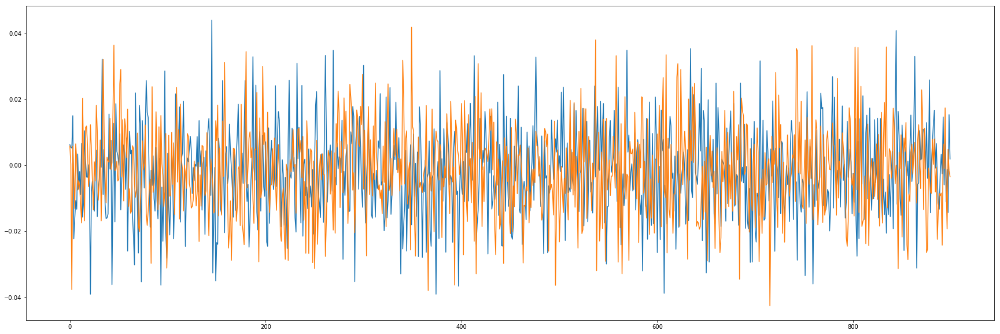

In [72]:
file_data = np.fromfile(open(data_file),dtype=np.complex64)
fig = plt.figure(figsize=(30,10))
ax = fig.add_subplot(111)

ax.plot(range(900),file_data[max_ind-900:max_ind].real)
ax.plot(range(900),file_data[max_ind-900:max_ind].imag)
plt.show()

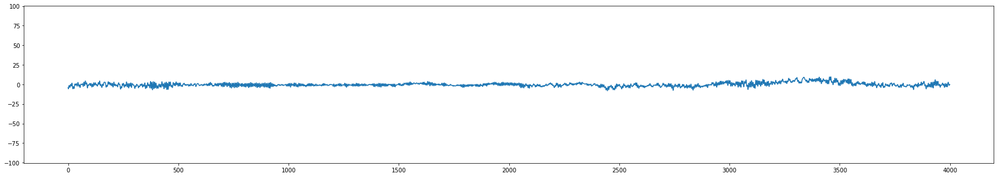

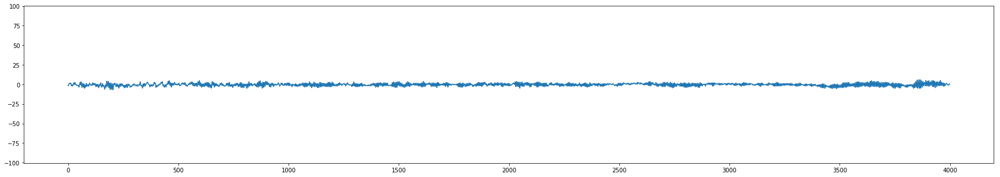

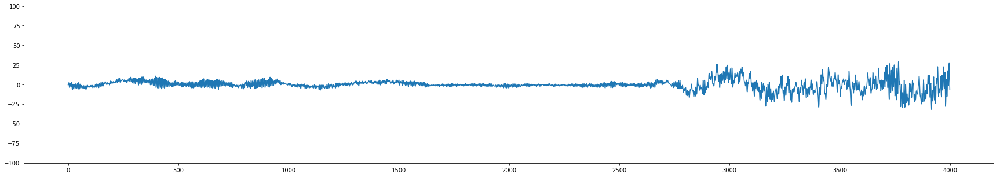

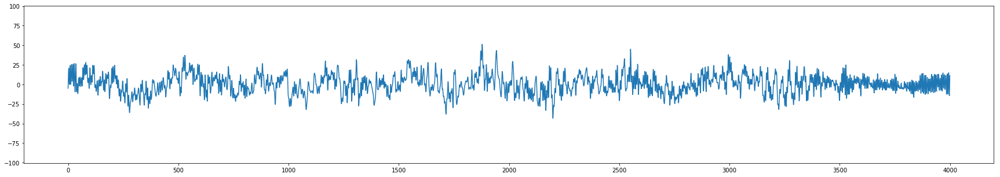

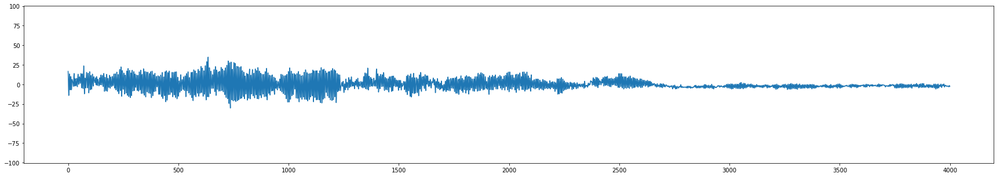

...

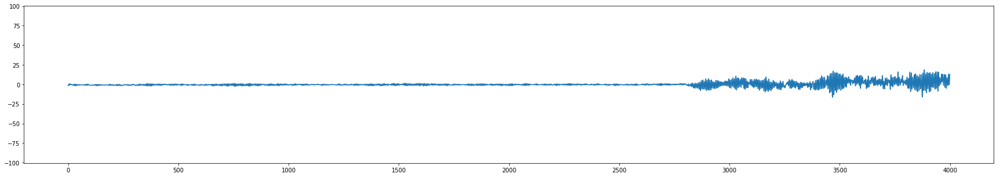

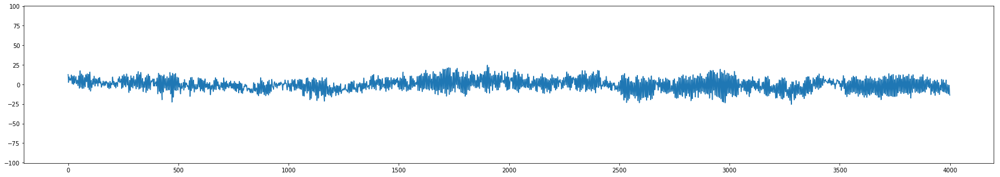

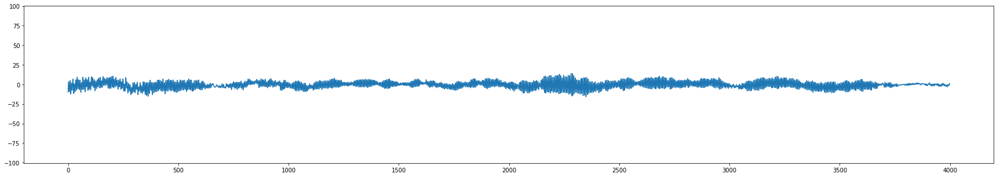

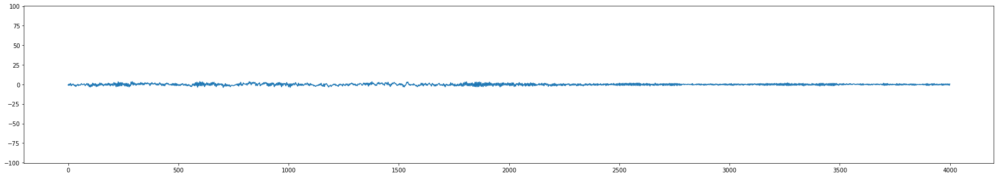

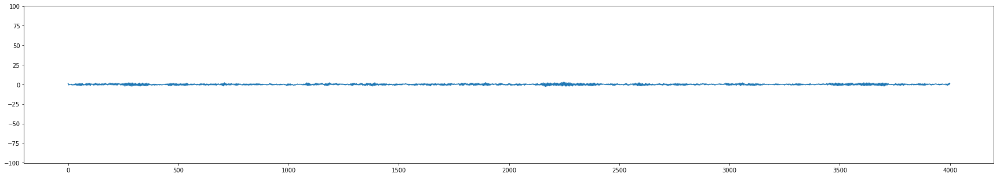

ValueError: x and y must have same first dimension, but have shapes (4000,) and (3882,)

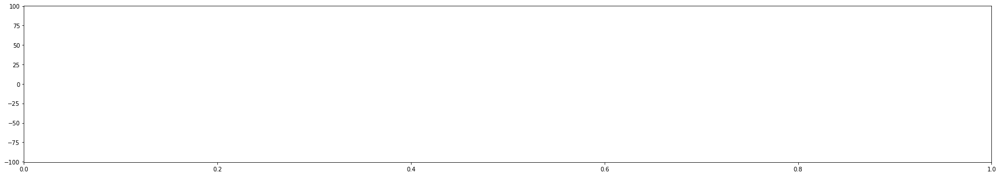

In [73]:

_ranger = 0
x = range(4000)
while _ranger<len(output_data):
    real = output_data[_ranger:_ranger+4000]
    fig = plt.figure(figsize=(30,5))
    ax = fig.add_subplot(111)
    plt.ylim(-100.5, 100.5)
    ax.plot(x,real)
    _ranger+=4000
    plt.show()
    

In [ ]:
file_data = np.fromfile(open(data_file),dtype=np.complex64)[1070000:1090000]
real_=file_data.real
imag_=file_data.imag
print "number imag:",len(imag_)
_ranger = 0
real = range(1000)
while _ranger<len(output_data):
    x = range(_ranger,_ranger+1000)
    fig = plt.figure(figsize=(30,9))
    plt.ylim(-60.5, 60.5)
    ax = fig.add_subplot(111)
    
    ax.plot(x,real_[_ranger:_ranger+1000])
    ax.plot(x,imag_[_ranger:_ranger+1000])
    
    _ranger+=1000
    plt.show()

In [3]:
import numpy as np
import pandas as pd

In [3]:
data = pd.read_csv("ble_data1.csv")

In [4]:
def detected(data, key="2cb84c"):
    data_map = []
    for da in data:
        if key in da:
            data_map.append(da)
            print da
    return data_map

In [7]:
set(detected(data["packet"].values,key="ef4124"))

430cbed6849a7b63ef41242cb84c97000a
430cbed6849a7b63ef41242cb84c97000a
430c385f048c5a55ef41242cb84c12131b
430c385f048c5a55ef41242cb84c12131b
430cbfe4630f8867ef41242cb84cf19403
430cbfe4630f8867ef41242cb84cf19403
430cb9e1ecafa244ef41242cb84ca84456
430cb9e1ecafa244ef41242cb84ca84456
430c7d4f4b3e0c43ef41242cb84c133f7d
430c7d4f4b3e0c43ef41242cb84c133f7d
430c708cf53b4e43ef41242cb84c11c0f0
430c708cf53b4e43ef41242cb84c11c0f0
430c2fad2c30af7aef41242cb84c4d9bb3
430c2fad2c30af7aef41242cb84c4d9bb3
430c9b292135887fef41242cb84c25baf7
430c9b292135887fef41242cb84c25baf7
430cb892905b1f77ef41242cb84cb028b2
430cb892905b1f77ef41242cb84cb028b2
430cde3217ecf37fef41242cb84c5ca3d9
430cde3217ecf37fef41242cb84c5ca3d9
430c61eedfe9f86cef41242cb84cfc598e
430c61eedfe9f86cef41242cb84cfc598e
430c2fad2c30af7aef41242cb84c4d9bb3
430c2fad2c30af7aef41242cb84c4d9bb3
430c523001b56a76ef41242cb84ce30e47
430c523001b56a76ef41242cb84ce30e47
430c5c0f55bcca4aef41242cb84c60b43f
430c5c0f55bcca4aef41242cb84c60b43f
430cb32e5e966a5fef41

{'430c006c66cf7250ef41242cb84cd4098b',
 '430c06a06600d45fef41242cb84cf0c40d',
 '430c095d522eec6eef41242cb84c07f3ce',
 '430c21ebbaf69f6eef41242cb84c9d88b3',
 '430c25bcf846f561ef41242cb84c700a3c',
 '430c26bce74edc7cef41242cb84cf0f475',
 '430c2fad2c30af7aef41242cb84c4d9bb3',
 '430c385f048c5a55ef41242cb84c12131b',
 '430c523001b56a76ef41242cb84ce30e47',
 '430c5806f9058b61ef41242cb84c553864',
 '430c5c0f55bcca4aef41242cb84c60b43f',
 '430c5e43fd174f7eef41242cb84ce98339',
 '430c61eedfe9f86cef41242cb84cfc598e',
 '430c708cf53b4e43ef41242cb84c11c0f0',
 '430c7d4f4b3e0c43ef41242cb84c133f7d',
 '430c90afbaf24d4fef41242cb84cf3706c',
 '430c9b292135887fef41242cb84c25baf7',
 '430ca4560c44687bef41242cb84cde3b8c',
 '430cae1c745a884bef41242cb84c3e215e',
 '430cb140107d7b43ef41242cb84c142bea',
 '430cb32e5e966a5fef41242cb84ce258fe',
 '430cb892905b1f77ef41242cb84cb028b2',
 '430cb9cb7d30b041ef41242cb84cb4a640',
 '430cb9e1ecafa244ef41242cb84ca84456',
 '430cbed6849a7b63ef41242cb84c97000a',
 '430cbfe4630f8867ef41242

In [6]:
set(data[data["packet"].isin(_map)]["raw"].tolist())

{'aad6be898e95c91610586b8bf9f4e48b6ec3022e6eac',
 'aad6be898e95c9182f0c622bc5f4e48b6ec302add4d4',
 'aad6be898e95c91a63a4c9aef1f4e48b6ec30224e3d2',
 'aad6be898e95c91c26a0db6aeef4e48b6ec30298588f',
 'aad6be898e95c925ce863719e3f4e48b6ec302313965',
 'aad6be898e95c934acace5afccf4e48b6ec302dca01b',
 'aad6be898e95c9396f12e0edccf4e48b6ec302de5f96',
 'aad6be898e95c942803fde35d0f4e48b6ec3023da4e6',
 'aad6be898e95c9444c3f1193dff4e48b6ec302196960',
 'aad6be898e95c94d7d0bf00de1f4e48b6ec302ca9325',
 'aad6be898e95c9619ca19814eef4e48b6ec302bd6ad7',
 'aad6be898e95c9629cbe903df3f4e48b6ec3023d949e',
 'aad6be898e95c965cbe3287ee1f4e48b6ec30250e858',
 'aad6be898e95c96b8d75ee4ef5f4e48b6ec30280fb58',
 'aad6be898e95c97c7f5d52bbdaf4e48b6ec302df73f0',
 'aad6be898e95c98586a9d80fe5f4e48b6ec3024f3aea',
 'aad6be898e95c989a176ed9ad5f4e48b6ec302b28ff6',
 'aad6be898e95c98a3bcaaa30fdf4e48b6ec3026e9a98',
 'aad6be898e95c98bc31ce418d3f4e48b6ec3026a6784',
 'aad6be898e95c98ddc732c79d7f4e48b6ec302e2f080',
 'aad6be898e95c98f18

In [29]:
data_ = detected(data["packet"].values, key="2cb84c")

430cbed6849a7b63ef41242cb84c97000a
430cbed6849a7b63ef41242cb84c97000a
430c385f048c5a55ef41242cb84c12131b
430c385f048c5a55ef41242cb84c12131b
030c1371da7d1a002b41242cb84cf8a68b
04062bb32f2cb84cf59932
04062bb32f2cb84cf59932
430cbfe4630f8867ef41242cb84cf19403
430cbfe4630f8867ef41242cb84cf19403
040695ae2f2cb84cfa9ac7
040695ae2f2cb84cfa9ac7
430c385f048c5a552bb32f2cb84c13d470
430c385f048c5a552bb32f2cb84c13d470
430cb9e1ecafa244ef41242cb84ca84456
430cb9e1ecafa244ef41242cb84ca84456
430c7d4f4b3e0c43ef41242cb84c133f7d
430c7d4f4b3e0c43ef41242cb84c133f7d
430c708cf53b4e43ef41242cb84c11c0f0
430c708cf53b4e43ef41242cb84c11c0f0
430c5c0f55bcca4a3441242cb84c55619b
430c5c0f55bcca4a3441242cb84c55619b
430c2fad2c30af7aef41242cb84c4d9bb3
430c2fad2c30af7aef41242cb84c4d9bb3
040695ae2f2cb84cfa9ac7
040695ae2f2cb84cfa9ac7
430c2fad2c30af7af972322cb84c781601
430c2fad2c30af7af972322cb84c781601
430cb6761b07bb6c2bb32f2cb84cb58050
430cb6761b07bb6c2bb32f2cb84cb58050
040695ae2f2cb84cfa9ac7
040695ae2f2cb84cfa9ac7
430c9b29213

In [30]:
len(data_)

302

In [26]:
filename = "picked_packets.csv"
_filenames=pd.read_csv(filename)["0"].values
_filenames

array(['aad6be898e96d826274a783afc19a4a9518402cd6ce5628ab893721f36f4495a5f1442460485072d4b642f10a9L',
       'aad6be898e96d826274a783afc19a4a9518402cd6ce5628ab893721f36f4495a5f1442460485072d4b642f10a9L',
       'aad6be898e96d829f798211de219a4a9518422cdbee54abb8135bbe79db34f80c084cbe1b33eae10bec486a3bfL',
       ...,
       'aad7be888e96d48a79eaf2ddf419a5a8448502cd71e869223f888ba5f508089455c813b8975ca72b4060818832L',
       '2a56be898e95c94fd799caaf46f9a0a3c459061e3ef0a0894d6522688d115aea9b7a314ba92948dc8b29caad69L',
       '2a56be898e95c94fd799caaf46f9a0a3c459061e3ef0a0894d6522688d115aea9b7a314ba92948dc8b29caad69L'],
      dtype=object)

In [27]:
import decoder
for ee in _filenames:
    decoder.__buffer__(ee);

mac address: 040695aeaf2cb84c7a1a47
mac_address: 040695aeaf2cb84c7a1a47
mac address: 040695aeaf2cb84c7a1a47
mac_address: 040695aeaf2cb84c7a1a47
mac address: 001de695412cb84c0201c2e2c7ef735715d5eb41a59ae7122e80a38f36727250b477
mac_address: 001de695412cb84c0201c2e2c7ef735715d5eb41a59ae7122e80a38f36727250b477
mac address: 001de695412cb84c0201c2e2c7ef735715d5eb41a59ae7122e80a38f36727250b477
mac_address: 001de695412cb84c0201c2e2c7ef735715d5eb41a59ae7122e80a38f36727250b477
mac_address: 0224efc1a4acb84c02
mac_address: 0224efc1a4acb84c02
mac_address: 0024fd8d81acb84c02
mac_address: 0024fd8d81acb84c02
mac address: 04066695412cb84cbc673e
mac_address: 04066695412cb84cbc673e
mac address: 04066695412cb84cbc673e
mac_address: 04066695412cb84cbc673e
mac_address: 4064bdcdc1ecb84c42
mac address: 0409fd0d012cb84c020a02816509
mac_address: 0409fd0d012cb84c020a02816509
mac address: 0409fd0d012cb84c020a02816509
mac_address: 0409fd0d012cb84c020a02816509
mac address: 0409fd0d012cb84c020a02816509
mac_address: 0

In [25]:
decoder.compute_hamnming_distance("2cb84c")

mac_address: 2cb84c


In [28]:
sorted(decoder.__map__)

['001d06e8472cb84c02010603020db10f160db1333e15dd4cb82c47e81ee508f67fa0',
 '001d06e8472cb84c02010603020db10f160db1333e15dd4cb82c47e81ee508f67fa0',
 '001d06e8472cb84c02010603020db10f160db1333e15dd4cb82c47e81ee508f67fa0',
 '001d06e8472cb84c02010603020db10f160db1333e15dd4cb82c47e81ee508f67fa0',
 '001d06e8472cb84c02010603020db10f160db1333e15dd4cb82c47e81ee508f67fa0',
 '001d4691412cb84c02010603020db10f164db1333e5a5aad609f2315f9f1a2e3ead6',
 '001d4691412cb84c02010603020db10f164db1333e5a5aad609f2315f9f1a2e3ead6',
 '001d4691412cb84c02010603020db10f164db1333e5a5aad609f2315f9f1a2e3ead6',
 '001d4691412cb84c02010603020db10f164db1333e5a5aad609f2315f9f1a2e3ead6',
 '001dabb32f2cb84c02018683820db10f960db1b3be15dd4cb82c2f332bb500860217',
 '001dabb32f2cb84c02018683820db10f960db1b3be15dd4cb82c2f332bb500860217',
 '001dabb32f2cb84c02018683820db10f960db1b3be15dd4cb82c2f332bb500860217',
 '001dabb32f2cb84c02018683820db10f960db1b3be15dd4cb82c2f332bb500860217',
 '001de695412cb84c02018683820db10f960db1b3be15dd4cb

In [11]:
l=['0224ef41242cb84c02',
 '0224ef41242cb84c02',
 '0224ef41242cb84c02',
 '0224ef41242cb84c02',
 '0224ef41242cb84c02',
 '0224ef41242cb84c02',
 '0224ef41242cb84c02',
 '0224ef41242cb84c02',
 '0224ef41242cb84c02',
 '0224ef41242cb84c02',
 '0224ef41242cb84c02',
 '0224ef41242cb84c02',
 '0224ef41242cb84c02',
 '0224ef41242cb84c02',
 '0224ef41242cb84c02',
 '0224ef41242cb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02',
 '0224efc1a4acb84c02']

In [67]:
packets = pd.read_csv("picked_cmt_packets.csv")
packets

,Unnamed: 0,dewhitened,raw
0,0,001dd2ce232cb84c02010603020db10f160db1333e15dd...,aad6be898ed6d896ee7af259c319a4a94179437c6ffd6f...
1,1,0224ef41242cb84c0201041aff4c00021537e3c199e744...,aad6be898ed4e1ab617df259c319a4ab588402cd62fe55...
2,2,002495ae2f2cb84c0201061aff4c000215340100dd3535...,aad6be898ed6e1d18e76f259c319a4a9588402cd62fe56...
3,3,001d95ae2f2cb84c02010603020db10f160db1333e15dd...,aad6be898ed6d8d18e76f259c319a4a94179437c6ffd6f...
4,4,0024fd0d012cb84c0201051aff4c000215b8fed8639f1c...,aad6be898ed6e1b92d58f259c319a4aa588402cd62feda...
5,5,0024f972322cb84c0201061aff4c000215340100dd3535...,aad6be898ed6e1bd526bf259c319a4a9588402cd62fe56...
6,6,0225ef41242cb84c0201041bffffefec407551931da46c...,aad6be898ed4e0ab617df259c319a4ab5984b1228cab17...
7,7,0409fd0d012cb84c020a02816509,aad6be898ed2ccb92d58f259c319afadc31e47
8,8,001d95ae2f2cb84c02010603020db10f160db1333e15dd...,aad6be898ed6d8d18e76f259c319a4a94179437c6ffd6f...
9,9,0024fd0d012cb84c0201051aff4c000215b8fed8639f1c...,aad6be898ed6e1b92d58f259c319a4aa588402cd62feda...


In [86]:
a = [{"a":2,"b":3},{"a":5,"b":6},{"a":8,"b":5}]
b = [{"a":4,"b":3},{"a":5,"b":12},{"a":823,"b":5}] 
df = pd.DataFrame(a)
df2 = pd.DataFrame(b)
pd.concat([df,df2],ignore_index=True)

,a,b
0,2,3
1,5,6
2,8,5
3,4,3
4,5,12
5,823,5


In [89]:
"aad6be898ed2c3ba9979f259c3518289"==

False

In [103]:
def compute_hamming_dist(s1,s2):
    assert len(s1)==len(s2), "not same length"
    binary = bin(int(s1,16)^int(s2,16)).count('1')
    print len(s2)*4-binary
    print binary

In [108]:

s1 = "aad6be898e95c95fc641f5caf1f4e48b6ec302"
s1 = "aad6be898e95c9c41e8b8786e9f4e48b6ec302"
s2 = "aad6be898e95c9d588da7ae1d4f4e48b6ec302"
s3 = "aad6be898e95c96e238d60a8f5f4e48b6ec302"
s4 = "aad6be898e95c91b146c61bbc2f4e48b6ec302"
s1 = "aad6be898ed6e1ab617df259c319a4a9588402cd62fe571c85f1dac587fb4dde84eb85171de0153da7d7b2"
s1 = "aad6be898ed4e1ab617df259c319a4ab588402cd62fe55c151b508b4880378ab3c2f475f3ce7153da7d7b2"
s2 = "aad6be898ed6e1ab617df259c319a4a9588402cd62fe55c151b508b4880378ab3c2f475f3ce7153da7d7b2"
compute_hamming_dist(s1,s2)

342
2


In [2]:
import numpy as np

#np.convolve(x, np.ones((N,))/N, mode='valid')
from  bitstring import BitArray
s2 = "aad6be898ed6e1ab617df259c319a4a9588402cd62fe55c151b508b4880378ab3c2f475f3ce7153da7d7b2"
bin_obj = BitArray(hex = s2);

In [4]:
bin_obj.bin

'10101010110101101011111010001001100011101101011011100001101010110110000101111101111100100101100111000011000110011010010010101001010110001000010000000010110011010110001011111110010101011100000101010001101101010000100010110100100010000000001101111000101010110011110000101111010001110101111100111100111001110001010100111101101001111101011110110010'

In [32]:
s1 = "aad6be898ed6e1ab617df259c319a4a9588402cd62fe55c151b508b4880378ab3c2f475f3ce7153da7d7b2"
s2 = "aad6be898ed6e6be898ed6e1ab617df259c319a4a9588402cd62fe55c151b508b4880378ab9c319a4a9588402cd62fe55c151b508b4880378ab3c2f475f3ce7153da7d7b2"
####performance
import numpy as np
def plus(s1,s2):
    for i in range(1000):
        s1+=s2
    return s1
def joining(s1,s2):
    for i in range(1000):
        s1="".join([s1,s2]);
    return s1
def add_np(s1,s2):
    for i in range(1000):
        s1 = np.add(s1,s2)
    return s1
start1 = time.time();
plus(s1,s2)
end1 = time.time();

start2 = time.time()
joining(s1,s2)
end2 = time.time()

start3 = time.time()
add_np(s1,s2)
end3 = time.time()
print (end1-start1),(end2 - start2),end3-start3

TypeError: ufunc 'add' did not contain a loop with signature matching types dtype('S137') dtype('S137') dtype('S137')

In [31]:
import numpy as np
s1 = "aad6be898ed6e1ab617df259c319a4a9588402cd62fe55c151b508b4880378ab3c2f475f3ce7153da7d7b2"
s2 = "aad6be898ed6e6be898ed6e1ab617df259c319a4a9588402cd62fe55c151b508b4880378ab9c319a4a9588"
lenght = len(s1)
def iterate_range(data1,data2):
    
    sum([int(data1[i],16) for i in range(lenght)]);
    
def iterate_xrange(data1,data2):
    sum([int(data1[i],16) for i in xrange(lenght)]);
def vect(dat1,length):
    return int(data[i],16)
def numpy_sol(data):
    vct = np.vectorize(vect)
    chars = 
start1 = time.time();
iterate_range(s1,s2)
end1 = time.time();

start2 = time.time()
iterate_xrange(s1,s2)
end2 = time.time()
print (end1-start1),(end2 - start2)

0.000137805938721 0.000133037567139


In [50]:
BLE_PREAMBLE_LEN = 1
BLE_ADDR_LEN = 4

####ERROR constraint constants
PRE_ERROR_LIMIT = 5
PAYLOAD_ERROR_LIMIT = 21
##preamble and access code
PREA_AND_ADDR = "aad6be898e"
PREA_AND_ADDR_LEN = len(PREA_AND_ADDR);

# packet of interest
PACKET_BODY = "d4e0ab617df259c319a4ab5984b1d373803183ab10953e489039dd3b36236a29f0b0c6f8ba00b9" #"b1d373803183ab10953e489039dd3b36236a29f0b0c6f8ba00b9";
PACKET_BODY_LEN = len(PACKET_BODY)/2;
####
characters = ["0","1","2","3","4","5","6","7","8","9","a","b","c","d","e","f"]
CHAR_DISTS = {(i,j):bin(int(i,16)^int(j,16)).count('1') for i in characters for j in characters}

hex_buffer = ["aa","d6","be","89","8e","d4","e0","ab","61","7d","f2","59","c3","19","a4","ab","59","84","b1","d3","73","80",
"31","83","ab","10","95","3e","48","90","39","dd","3b","36","23","6a","29","f0","b0","c6","f8","ba","00","b9"]



def normal():
    count=0
    for pos ,byte, in enumerate(hex_buffer):
        if len(hex_buffer[pos:])<BLE_ADDR_LEN+BLE_PREAMBLE_LEN:
            break
        
        pre_add = ("").join(hex_buffer[pos:pos+BLE_PREAMBLE_LEN+BLE_ADDR_LEN])
        
        pre_dist = sum([CHAR_DISTS[(pre_add[i],PREA_AND_ADDR[i])] for i in range(PREA_AND_ADDR_LEN)]);

          
        if pre_dist>PRE_ERROR_LIMIT:
            continue

        count+=1
        if count%59==0:
            print "advertisement found:",pre_add,"count:",count

        pos+= BLE_PREAMBLE_LEN+BLE_ADDR_LEN

        packet_body  = hex_buffer[pos:pos+PACKET_BODY_LEN];

        
        if len(packet_body)<PACKET_BODY_LEN:
            #lost_data = _buffer[pos-(BLE_PREAMBLE_LEN+BLE_ADDR_LEN):]
            break

        packet_body_hex = ("").join(packet_body)

          

        packet_dist = sum([CHAR_DISTS[(packet_body_hex[i],PACKET_BODY[i])] for i in range(PACKET_BODY_LEN*2)])

        if packet_dist<PAYLOAD_ERROR_LIMIT:
            print "packet:",packet_body_hex,"errors:",packet_dist
def lookup_dist(byte1,byte2):
    return CHAR_DISTS[(byte1[0],byte2[0])]+CHAR_DISTS[(byte1[1],byte2[1])]
PREA_AND_ADDR = ["aa","d6","be","89","8e"]
PACKET_BODY = ["d4","e0","ab","61","7d","f2","59","c3","19","a4","ab","59","84","b1","d3","73",
"80","31","83","ab","10","95","3e","48","90","39","dd","3b","36","23","6a","29","f0","b0","c6","f8","ba","00","b9"]

def numpy_function():
    count=0
    
    for pos ,byte, in enumerate(hex_buffer):
        if len(hex_buffer[pos:])<BLE_ADDR_LEN+BLE_PREAMBLE_LEN:
            break
        
        #pre_add = hex_buffer[pos:pos+BLE_PREAMBLE_LEN+BLE_ADDR_LEN]
        vect = np.vectorize(lookup_dist)
        pre_dist = np.sum(vect(PREA_AND_ADDR,hex_buffer[pos:pos+BLE_PREAMBLE_LEN+BLE_ADDR_LEN]))
        
        #pre_dist = sum([CHAR_DISTS[(pre_add[i],PREA_AND_ADDR[i])] for i in range(PREA_AND_ADDR_LEN)]);

          
        if pre_dist>PRE_ERROR_LIMIT:
            continue

        count+=1
        if count%59==0:
            print "advertisement found:",pre_add,"count:",count

        pos+= BLE_PREAMBLE_LEN+BLE_ADDR_LEN

        packet_body  = hex_buffer[pos:pos+PACKET_BODY_LEN];
        packet_body_hex = ("").join(hex_buffer[pos:pos+PACKET_BODY_LEN])

        
        if len(packet_body)<PACKET_BODY_LEN:
            #lost_data = _buffer[pos-(BLE_PREAMBLE_LEN+BLE_ADDR_LEN):]
            break

        
        
        
        

          

        
        #packet_dist = sum([CHAR_DISTS[(packet_body_hex[i],PACKET_BODY[i])] for i in range(PACKET_BODY_LEN*2)])
        packet_dist = np.sum(hex_buffer[pos:pos+PACKET_BODY_LEN],PACKET_BODY)

        if packet_dist<PAYLOAD_ERROR_LIMIT:
            print "packet:",packet_body_hex,"errors:",packet_dist
#normal()
numpy_function()

TypeError: cannot perform reduce with flexible type

In [22]:
l = [23]*10000
x = len(l)
import time
start0 = time.time();
for by in xrange(x):
    
    pass
end0 = time.time();

start1 = time.time();
for by,y in enumerate(l):
    pass
end1 = time.time();

start2 = time.time()
for by in l:
    pass
end2 = time.time()
print (end0-start0),(end1-start1),(end2 - start2)

0.00139999389648 0.00291609764099 0.000627994537354


In [26]:
mylist = [35, 248, 255, 99, 160, 129, 255, 209, 191, 211, 127, 4, 64, 87, 26, 2, 176, 243, 189, 252, 66, 31, 122, 109, 142, 63, 0, 62, 6, 22, 140, 240, 7, 76, 252, 255, 255, 211, 55, 1, 4, 18, 120, 13, 77, 170, 106, 251, 92, 102, 62, 48, 248, 69, 195, 49, 192, 31, 0, 62, 255, 255, 255, 31, 204, 145, 7, 244, 255, 101, 197, 61, 250, 212, 21, 0, 192, 19, 112, 138, 245, 21, 248, 47, 24, 9, 224, 77, 0, 48, 162, 128, 249, 42, 0, 212, 183, 233, 231, 243, 198, 75, 126, 172, 121, 168, 169, 149, 253, 0, 107, 224, 63, 64, 25, 108, 48, 0, 166, 199, 6, 0, 213, 223, 157, 61, 232, 161, 150, 85, 214, 234, 142, 150, 110, 122, 116, 171, 194, 89, 42, 158, 82, 129, 165, 32, 253, 182, 188, 31, 88, 34, 252, 158, 226, 239, 170, 64, 120, 44, 154, 92, 181, 58, 188, 160, 39, 36, 44, 218, 118, 250, 135, 252, 14, 212, 174, 136, 105, 210, 150, 24, 74, 158, 203, 137, 53, 147, 29, 239, 251, 239, 189, 110, 107, 52, 96, 78, 224, 25, 110, 98, 145, 121, 83, 28, 242, 92, 152, 143, 127, 244, 201, 71, 85, 213, 218, 55, 209, 209, 18, 219, 107, 32, 39, 80, 155, 58, 131, 52, 53, 138, 80, 160, 153, 173, 92, 140, 102, 188, 91, 100, 125, 187, 107, 253, 141, 229, 45, 146, 15, 78, 178, 230, 104, 37, 2, 179, 184, 208, 127, 19, 79, 250, 116, 9, 184, 221, 20, 127, 171, 248, 3, 0, 189, 176, 84, 135, 2, 4, 1]

In [28]:
hex(4)

'0x4'